Fresh Start using new dataset measured in Oct-Nov 2024 period using the Qualipoc tool.

In [3]:
%reset -f

import pandas as pd
import numpy as np
import folium
import matplotlib.pyplot as plt
import branca.colormap as cm

import sys
sys.path.append('../python')
from earfcn_to_freq import earfcn_to_freq

import os
print(os.getcwd())

d:\OneDrive - nd.edu\ND Courses\2024 Fall\ACMS 80870 Topics in Statistics\acms80870_project_palathinkal\final_project\notebooks


In [4]:
df = pd.read_csv('../data/qualipoc_data/cbrs_radio_2024_oct_nov.csv', sep=";")
df.rename(columns={'PCI/PSC/BSIC': 'PCI'}, inplace=True)
df['Frequency'] = df['DL EARFCN'].apply(earfcn_to_freq)
df = df[df['DL Bandwidth'] == 20]
df.drop(columns=['Date', 'Time', 'Device Name', 'Carrier Index', 'Technology Band', 'Band Number', 'DL EARFCN', 'SCC Index', 'TxAntennas',\
                 'Frequency Number', 'DL Subcarrier Spacing', 'DL Carriers Radio', 'Cell Id', 'eNB-Id', 'Sector Id', 'Operator', 'DL Bandwidth'], inplace=True)

pci_map = {
    0: { 'BS': 1, 'Latitude': 41.65425, 'Longitude': -86.242694, 'Azimuth': 60, 'Downtilt': 4, 'Height': 21, 'Frequency': 3670 },
    3: { 'BS': 1, 'Latitude': 41.65425, 'Longitude': -86.242694, 'Azimuth': 120, 'Downtilt': 4, 'Height': 21, 'Frequency': 3640 },
    6: { 'BS': 1, 'Latitude': 41.65425, 'Longitude': -86.24375, 'Azimuth': 180, 'Downtilt': 4, 'Height': 21, 'Frequency': 3580 },
    9: { 'BS': 1, 'Latitude': 41.65425, 'Longitude': -86.24375, 'Azimuth': 240, 'Downtilt': 4, 'Height': 21, 'Frequency': 3690 },
    12: { 'BS': 1, 'Latitude': 41.654639, 'Longitude': -86.24375, 'Azimuth': 300, 'Downtilt': 4, 'Height': 29, 'Frequency': 3560 },
    15: { 'BS': 1, 'Latitude': 41.654639, 'Longitude': -86.24375, 'Azimuth': 0, 'Downtilt': 4, 'Height': 29, 'Frequency': 3580 },
    18: { 'BS': 4, 'Latitude': 41.668678, 'Longitude': -86.312222, 'Azimuth': 70, 'Downtilt': -1, 'Height': 12, 'Frequency': 3690 },
    21: { 'BS': 4, 'Latitude': 41.668678, 'Longitude': -86.312222, 'Azimuth': 130, 'Downtilt': -1, 'Height': 12, 'Frequency': 3640 },
    24: { 'BS': 2, 'Latitude': 41.663278, 'Longitude': -86.254139, 'Azimuth': 60, 'Downtilt': 4, 'Height': 44, 'Frequency': 3670 },
    27: { 'BS': 2, 'Latitude': 41.663278, 'Longitude': -86.254139, 'Azimuth': 120, 'Downtilt': 4, 'Height': 44, 'Frequency': 3640 },
    30: { 'BS': 2, 'Latitude': 41.663278, 'Longitude': -86.254139, 'Azimuth': 180, 'Downtilt': 4, 'Height': 44, 'Frequency': 3580 },
    33: { 'BS': 2, 'Latitude': 41.663278, 'Longitude': -86.254139, 'Azimuth': 240, 'Downtilt': 4, 'Height': 44, 'Frequency': 3690 },
    36: { 'BS': 2, 'Latitude': 41.663278, 'Longitude': -86.254139, 'Azimuth': 300, 'Downtilt': 4, 'Height': 44, 'Frequency': 3560 },
    39: { 'BS': 2, 'Latitude': 41.663278, 'Longitude': -86.254139, 'Azimuth': 0, 'Downtilt': 4, 'Height': 44, 'Frequency': 3580 },
    42: { 'BS': 3, 'Latitude': 41.67225, 'Longitude': -86.292778, 'Azimuth': 120, 'Downtilt': 4, 'Height': 33, 'Frequency': 3670 },
    45: { 'BS': 3, 'Latitude': 41.67225, 'Longitude': -86.292778, 'Azimuth': 180, 'Downtilt': 4, 'Height': 33, 'Frequency': 3640 },
    48: { 'BS': 3, 'Latitude': 41.67225, 'Longitude': -86.292778, 'Azimuth': 240, 'Downtilt': 4, 'Height': 33, 'Frequency': 3690 },
    51: { 'BS': 3, 'Latitude': 41.67225, 'Longitude': -86.292778, 'Azimuth': 300, 'Downtilt': 4, 'Height': 33, 'Frequency': 3580 },
}
df_pci_map = pd.DataFrame.from_dict(pci_map, orient='index').reset_index()
df_pci_map.rename(columns={'index': 'PCI'}, inplace=True)
del pci_map

In [71]:
merged_df = df.merge(df_pci_map[['PCI', 'Frequency']], on=['PCI', 'Frequency'], how='left')
merged_df['Match'] = merged_df['Frequency'].notna()
mismatched_rows = merged_df[~merged_df['Match']]
if not mismatched_rows.empty:
    print("Mismatched rows:")
    print(mismatched_rows)
else:
    print("All PCI and Frequency pairs match with pci_map.")
del merged_df, mismatched_rows

All PCI and Frequency pairs match with pci_map.


In [72]:
df = df.merge(df_pci_map[['PCI', 'BS', 'Latitude', 'Longitude', 'Azimuth', 'Downtilt', 'Height']], on='PCI', how='left')
df.rename(columns={'Latitude_x': 'Latitude', 'Latitude_y': 'bs_Latitude', 'Longitude_x': 'Longitude', 'Longitude_y': 'bs_Longitude',\
                   'Azimuth': 'bs_Azimuth', 'Downtilt': 'bs_Downtilt', 'Height': 'bs_Height'}, inplace=True)
print(df.head())

            Full Date Time  PCI  RSRP  RSSI (LTE)  RSRQ  SINR   Latitude  \
0  2024-11-02 13:58:13.571   33 -85.0       -53.7  -9.8  28.6  41.661505   
1  2024-11-02 13:58:13.061   33 -86.8       -55.2  -9.7  29.7  41.661505   
2  2024-11-02 13:58:12.554   33 -85.3       -54.0  -9.3  28.4  41.661504   
3  2024-11-02 13:58:12.054   33 -85.5       -55.5  -7.3  29.0  41.661504   
4  2024-11-02 13:58:11.554   33 -85.2       -53.9  -9.8  29.5  41.661504   

   Longitude  Frequency  BS  bs_Latitude  bs_Longitude  bs_Azimuth  \
0 -86.257479     3690.0   2    41.663278    -86.254139         240   
1 -86.257479     3690.0   2    41.663278    -86.254139         240   
2 -86.257484     3690.0   2    41.663278    -86.254139         240   
3 -86.257484     3690.0   2    41.663278    -86.254139         240   
4 -86.257483     3690.0   2    41.663278    -86.254139         240   

   bs_Downtilt  bs_Height  
0            4         44  
1            4         44  
2            4         44  
3         


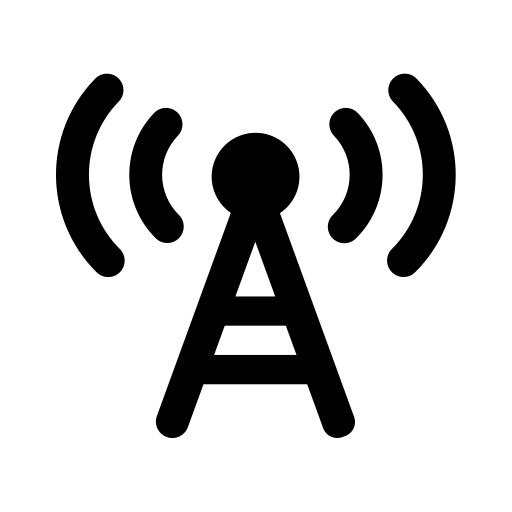
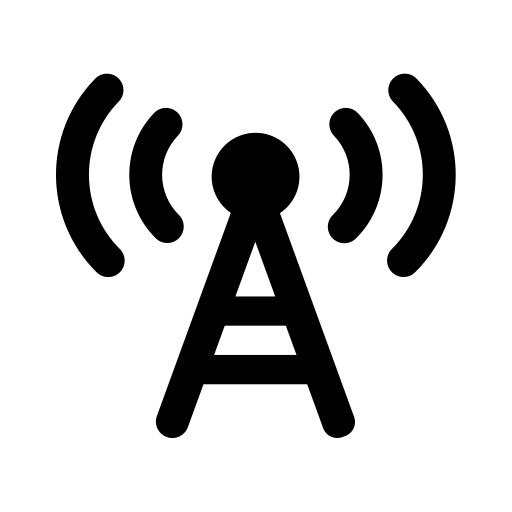
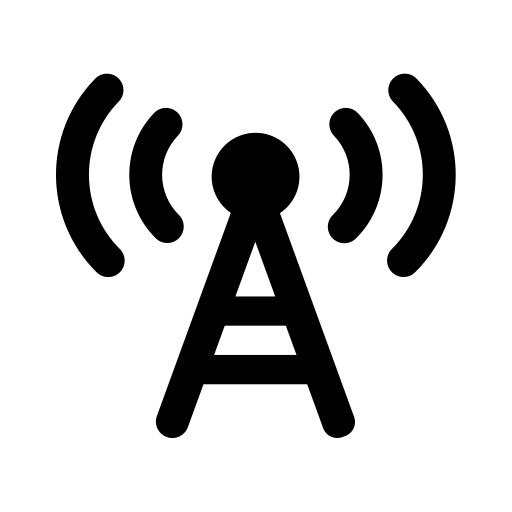
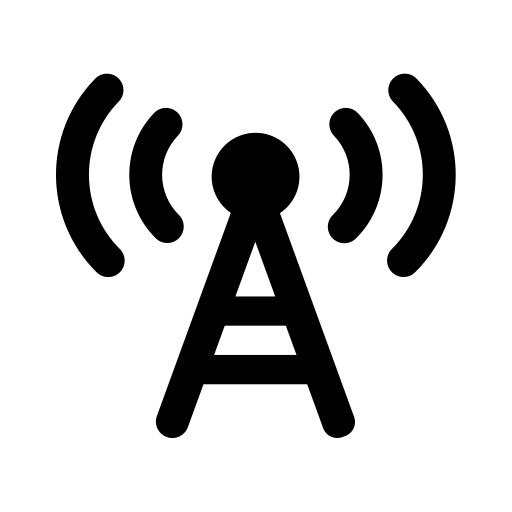

In [81]:
bounds = [[df['Latitude'].min(), df['Longitude'].min()],
          [df['Latitude'].max(), df['Longitude'].max()]]

fig = folium.Figure(width=1000, height=800)
map = folium.Map(tiles="OpenStreetMap", control_scale=True).add_to(fig)
map.fit_bounds(bounds)

map_input_data = list(df[["Latitude", "Longitude"]].itertuples(index=False, name=None))
for marker in map_input_data:
    folium.CircleMarker(location=[marker[0],marker[1]], color="blue", opacity=0.2, radius=3).add_to(map)

bs_info = pd.DataFrame()
bs_info['bs_name'] = ['BS1', 'BS2', 'BS3', 'BS4']
bs_info['bs_lat'] = [41.65425, 41.663278, 41.67225, 41.668678]
bs_info['bs_lon'] = [-86.24375, -86.254139, -86.292778, -86.312222]
for index, row in bs_info.iterrows():
    base_station_icon = folium.features.CustomIcon('../data/base_station.png',icon_size=(50, 50))
    folium.Marker([row['bs_lat'],row['bs_lon']],icon=base_station_icon).add_to(map)

coverage_border = pd.read_csv('../data/coverage_map.csv')
for index, row in coverage_border.iterrows():
    coords_str = row['coordinates'][1:-1]  # Remove the brackets
    coords_pairs = coords_str.split("), (")  # Split by the pairs
    temp = []
    for pair in coords_pairs:
        lat, lon = pair.split(", ")
        temp.append((float(lat.strip("()")), float(lon.strip("()"))))
    coverage_coordinates = temp
    del temp
    folium.Polygon(locations=coverage_coordinates, color='black',fill=True, fill_color='black', fill_opacity=0.15).add_to(map)

display(map)

del bounds, fig, map, map_input_data, marker, bs_info


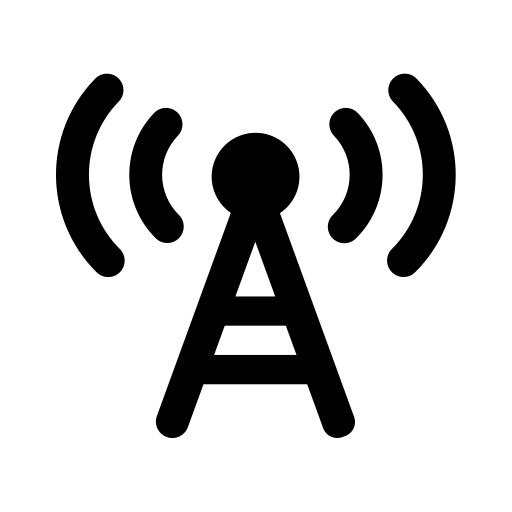
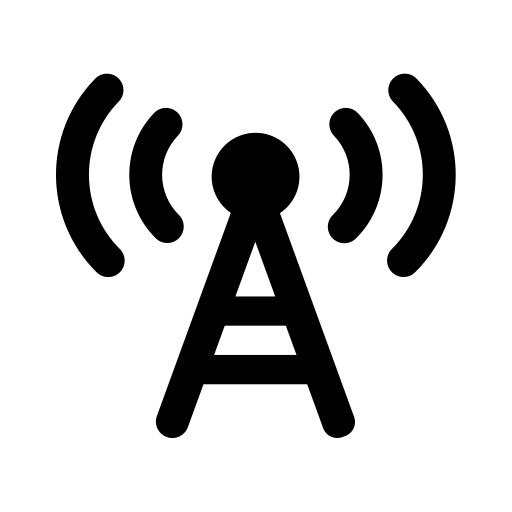
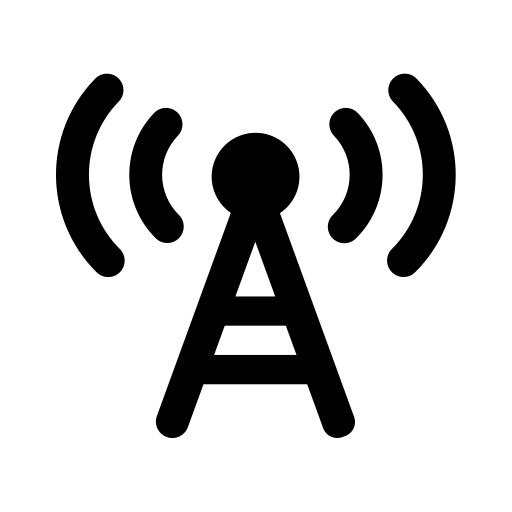
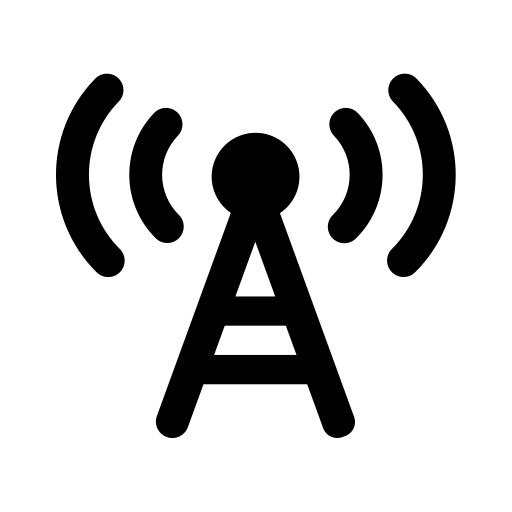

In [82]:
df_pci45 = df[df['PCI'] == 45]

bounds = [[df_pci45['Latitude'].min(), df_pci45['Longitude'].min()],
          [df_pci45['Latitude'].max(), df_pci45['Longitude'].max()]]

fig = folium.Figure(width=1000, height=800)
map = folium.Map(tiles="OpenStreetMap", control_scale=True).add_to(fig)
map.fit_bounds(bounds)

colormap = cm.LinearColormap(
    ['red', 'orange', 'yellow', 'green'],
    vmin=min(df_pci45['RSRP']),
    vmax=max(df_pci45['RSRP'])
    ).to_step(index=np.linspace(min(df_pci45['RSRP']), max(df_pci45['RSRP']), 5)).add_to(map)

map_input_data = list(df_pci45[["Latitude", "Longitude", "RSRP"]].itertuples(index=False, name=None))
for marker in map_input_data:
    folium.CircleMarker(location=[marker[0],marker[1]], color=colormap(marker[2]), radius=4, fill=True, fill_color=colormap(marker[2]), fill_opacity=0.7).add_to(map)

bs_info = pd.DataFrame()
bs_info['bs_name'] = ['BS1', 'BS2', 'BS3', 'BS4']
bs_info['bs_lat'] = [41.65425, 41.663278, 41.67225, 41.668678]
bs_info['bs_lon'] = [-86.24375, -86.254139, -86.292778, -86.312222]
for index, row in bs_info.iterrows():
    base_station_icon = folium.features.CustomIcon('../data/base_station.png',icon_size=(50, 50))
    folium.Marker([row['bs_lat'],row['bs_lon']],icon=base_station_icon).add_to(map)

coverage_border = pd.read_csv('../data/coverage_map.csv')
for index, row in coverage_border.iterrows():
    coords_str = row['coordinates'][1:-1]  # Remove the brackets
    coords_pairs = coords_str.split("), (")  # Split by the pairs
    temp = []
    for pair in coords_pairs:
        lat, lon = pair.split(", ")
        temp.append((float(lat.strip("()")), float(lon.strip("()"))))
    coverage_coordinates = temp
    del temp
    folium.Polygon(locations=coverage_coordinates, color='black',fill=True, fill_color='black', fill_opacity=0.15).add_to(map)

display(map)